# Advanced Lane finding

This notebook explains the steps of my pipeline.

#### Globals / library functions
Used in various places in code, run this every time.

In [8]:
from collections import deque

#camera calibration path
camcalpath = 'camera_cal/'

#lane test images path
lanetestpath = 'test_images/'
#warped lane test images path
warpedtestpath = lanetestpath + 'warped/'

#more images, extracted from videos
moretestpath = 'more_images/'
#warped path
morewarpedtestpath = moretestpath + 'warped/'

# from course: define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        #!filename of line if image, or frame if video, used during iterations
        self.fname = None
        #detected line pixels
        self.data_points = None
        
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #polynomial coefficients for the most recent fit
        self.xfitted = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None
        
        # was the line detected in the last iteration?
        self.detected = False
        # x values of the last n fits of the line
        self.recent_xfitted = deque(np.array([]),30)
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 


# Camera calibration

## Finding object and image points
Use the chessboard pattern to find image points in a series of test images, and store those points.

fname:  camera_cal/calibration1.jpg  idx:  0
fname:  camera_cal/calibration10.jpg  idx:  1
found!


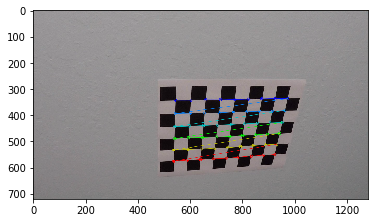

fname:  camera_cal/calibration11.jpg  idx:  2
found!


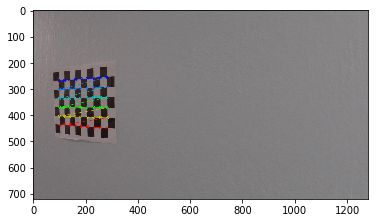

fname:  camera_cal/calibration12.jpg  idx:  3
found!


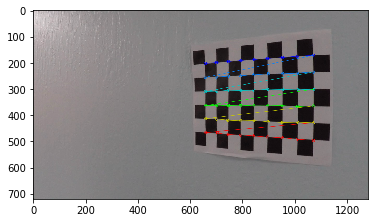

fname:  camera_cal/calibration13.jpg  idx:  4
found!


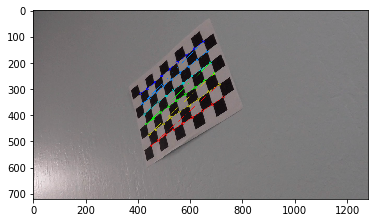

fname:  camera_cal/calibration14.jpg  idx:  5
found!


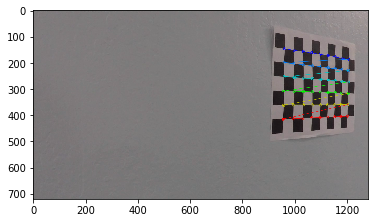

fname:  camera_cal/calibration15.jpg  idx:  6
found!


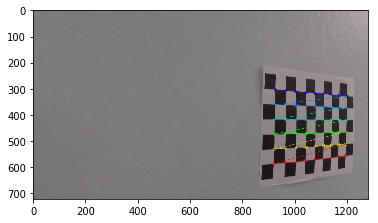

fname:  camera_cal/calibration16.jpg  idx:  7
found!


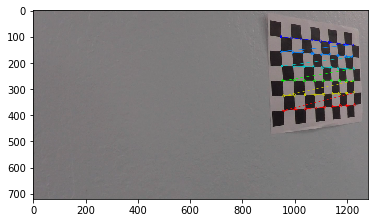

fname:  camera_cal/calibration17.jpg  idx:  8
found!


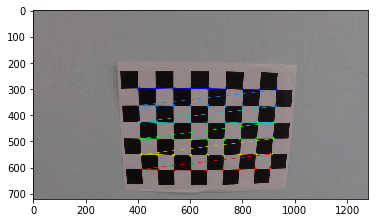

fname:  camera_cal/calibration18.jpg  idx:  9
found!


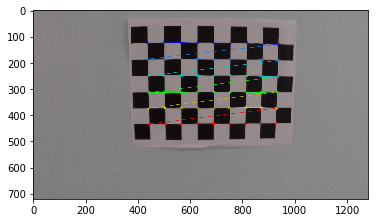

fname:  camera_cal/calibration19.jpg  idx:  10
found!


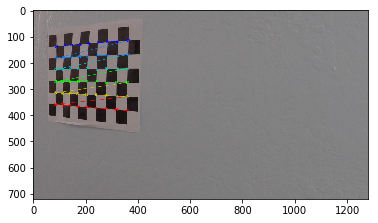

fname:  camera_cal/calibration2.jpg  idx:  11
found!


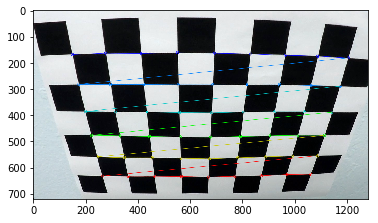

fname:  camera_cal/calibration20.jpg  idx:  12
found!


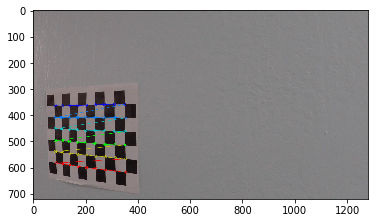

fname:  camera_cal/calibration3.jpg  idx:  13
found!


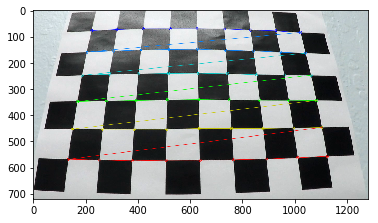

fname:  camera_cal/calibration4.jpg  idx:  14
fname:  camera_cal/calibration5.jpg  idx:  15
fname:  camera_cal/calibration6.jpg  idx:  16
found!


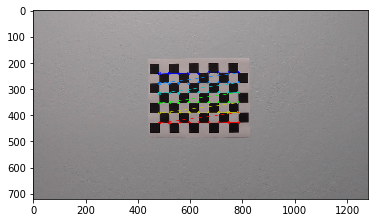

fname:  camera_cal/calibration7.jpg  idx:  17
found!


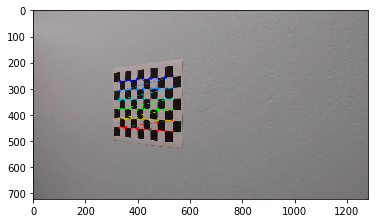

fname:  camera_cal/calibration8.jpg  idx:  18
found!


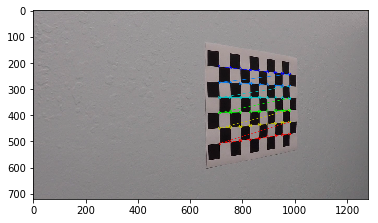

fname:  camera_cal/calibration9.jpg  idx:  19
found!


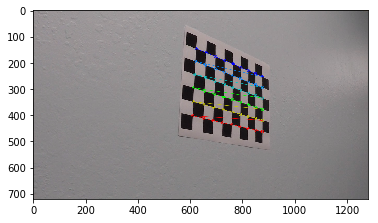

In [9]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib inline

#corner sizes
nx = 9
ny = 6

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((nx*ny,3), np.float32)
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob(camcalpath + 'calibration*.jpg')

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    img_size = (img.shape[1], img.shape[0])
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    print('fname: ', fname, ' idx: ', idx)
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)
    
    # If found, add object points, image points
    if ret == True:
        print('found!')
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
        write_name = camcalpath + 'corners_found'+str(idx)+'.jpg'
        cv2.imwrite(write_name, img)
        plt.figure()
        plt.imshow(img, cmap='gray')
        plt.show()

## Generate calibration matrix and distortion correction

Using the combination of object and image points from the images above, generate a camera matrix and distortion coefficient matrix. 

Store it so we don't have to do the two steps above repeatedly.

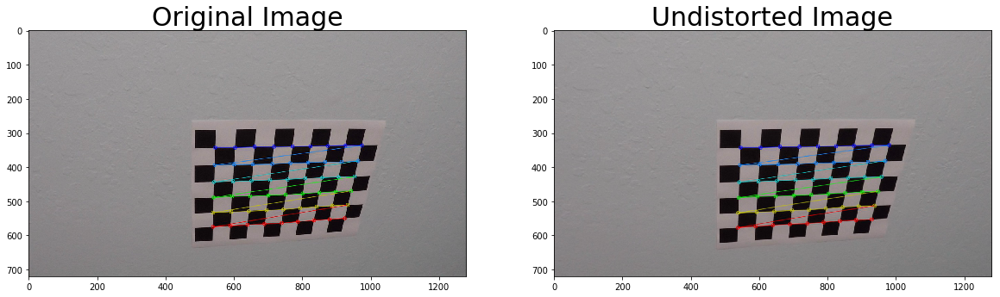

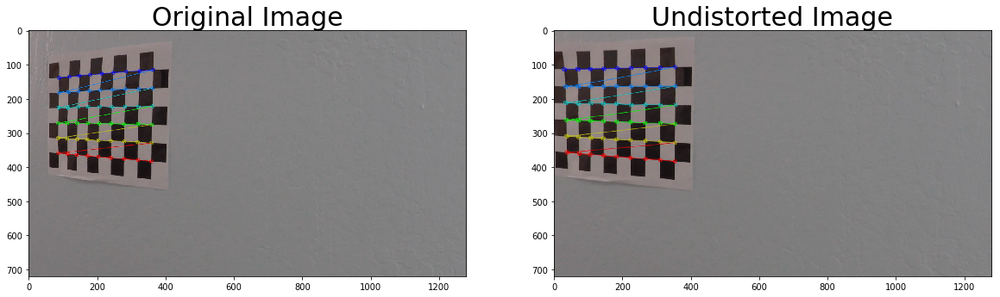

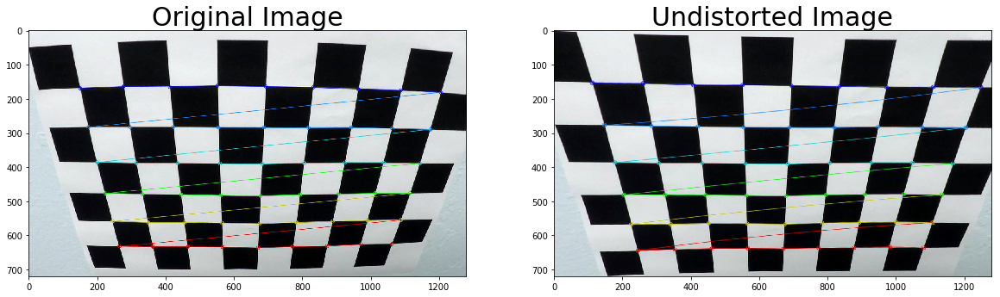

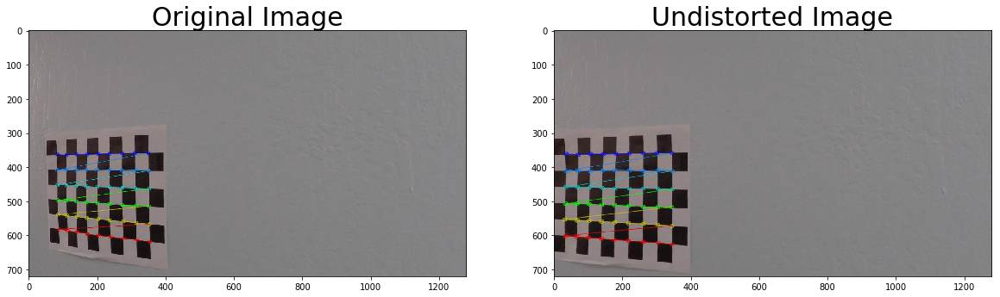

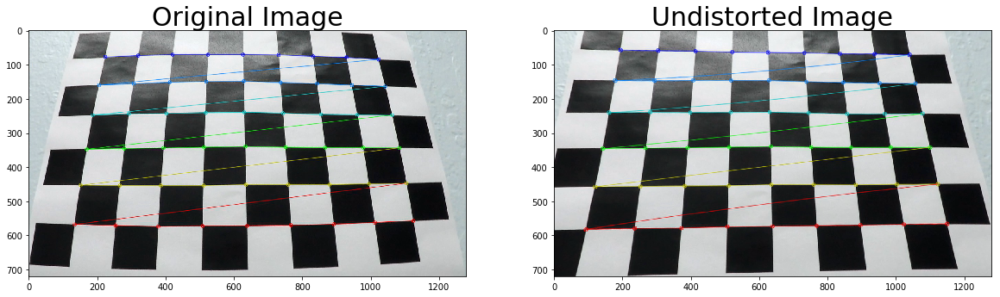

...

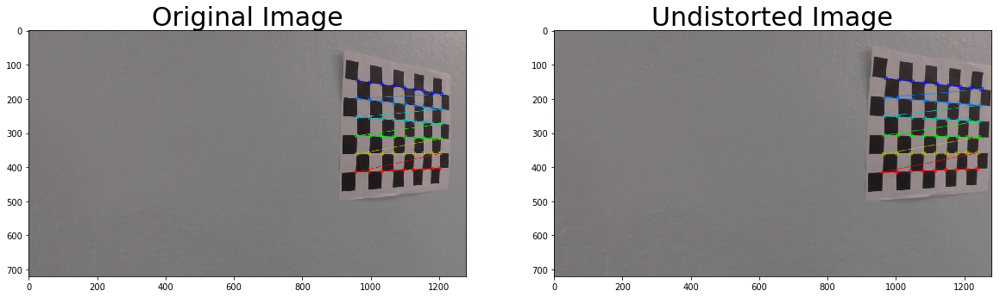

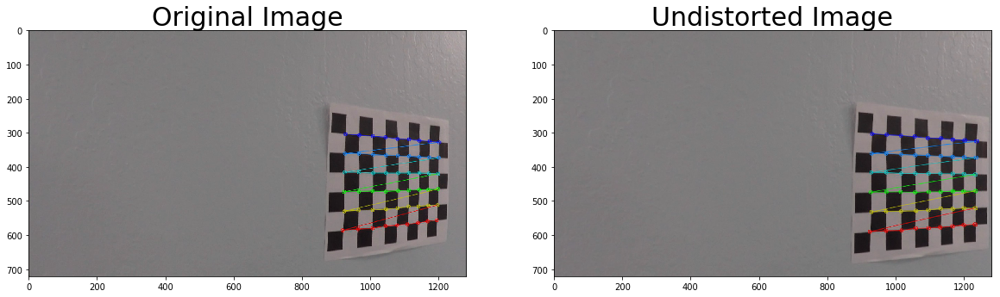

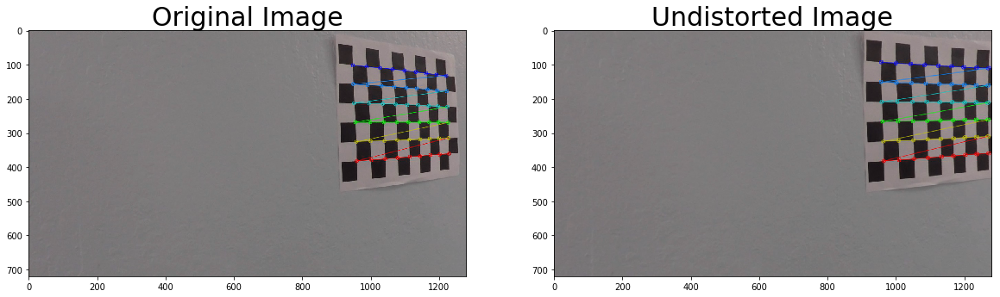

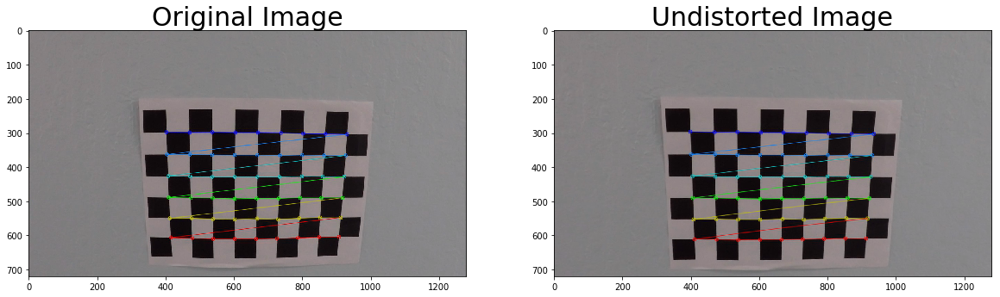

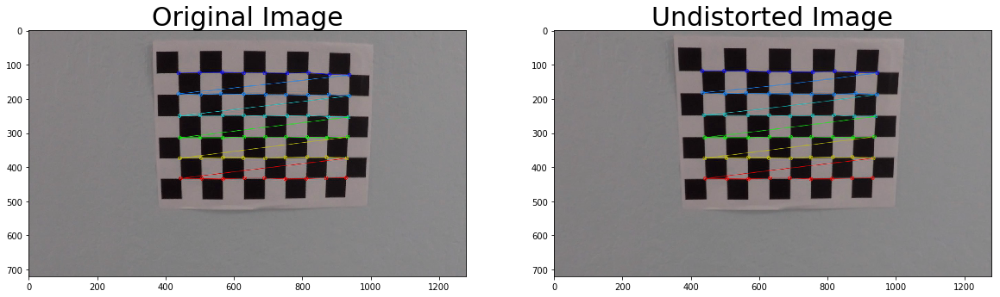

In [10]:
import pickle

# Test undistortion on an image
#img = cv2.imread('calibration_wide/test_image.jpg')
#img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None,None)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( camcalpath + "dist_pickle.p", "wb" ) )

# undistort function, corrects for camera distortion
def undistort(img, mtx, dist):
    return cv2.undistort(img, mtx, dist, None, mtx)    

# Make a list of calibration images with corners drawn
images = glob.glob(camcalpath + 'corners_found*.jpg')

# Step through the list and undistort images
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    dst = undistort(img, mtx, dist)
    cv2.imwrite(camcalpath + 'undist' + str(idx) + '.jpg',dst)
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(dst)
    ax2.set_title('Undistorted Image', fontsize=30)


# Single image pipeline

## Get images from videos
This step isn't required. It extracts images out the harder videos so that the steps can be tweaked.

In [11]:
from moviepy.editor import VideoFileClip

project_video = 'project_video.mp4'
project_images_format = 'more_images/' + project_video.split('.')[0] + '-%03d.jpg'
challenge_video = 'challenge_video.mp4'
challenge_images_format = 'more_images/' + challenge_video.split('.')[0] + '-%03d.jpg'
harder_challenge_video = 'harder_challenge_video.mp4'
harder_challenge_images_format = 'more_images/' + harder_challenge_video.split('.')[0] + '-%03d.jpg'


challenge_clip = VideoFileClip(challenge_video)
challenge_clip.write_images_sequence(challenge_images_format, fps=1)

#harder_challenge_clip = VideoFileClip(harder_challenge_video)
#harder_challenge_clip.write_images_sequence(harder_challenge_images_format, fps=1)

[MoviePy] Writing frames more_images/challenge_video-%03d.jpg.

100%|██████████| 17/17 [00:02<00:00,  6.33it/s]

[MoviePy]: Done writing frames more_images/challenge_video-%03d.jpg.



['more_images/challenge_video-000.jpg',
 'more_images/challenge_video-001.jpg',
 'more_images/challenge_video-002.jpg',
 'more_images/challenge_video-003.jpg',
 'more_images/challenge_video-004.jpg',
 'more_images/challenge_video-005.jpg',
 'more_images/challenge_video-006.jpg',
 'more_images/challenge_video-007.jpg',
 'more_images/challenge_video-008.jpg',
 'more_images/challenge_video-009.jpg',
 'more_images/challenge_video-010.jpg',
 'more_images/challenge_video-011.jpg',
 'more_images/challenge_video-012.jpg',
 'more_images/challenge_video-013.jpg',
 'more_images/challenge_video-014.jpg',
 'more_images/challenge_video-015.jpg',
 'more_images/challenge_video-016.jpg']

## Transform perspective

Convert lane images from center camera perspective to top-down perspective.

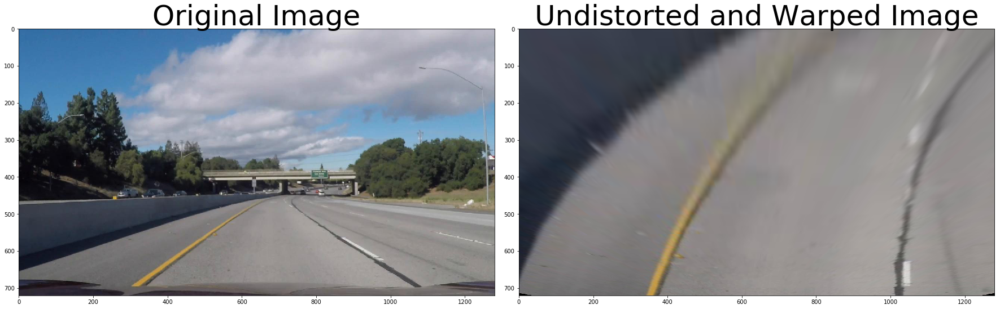

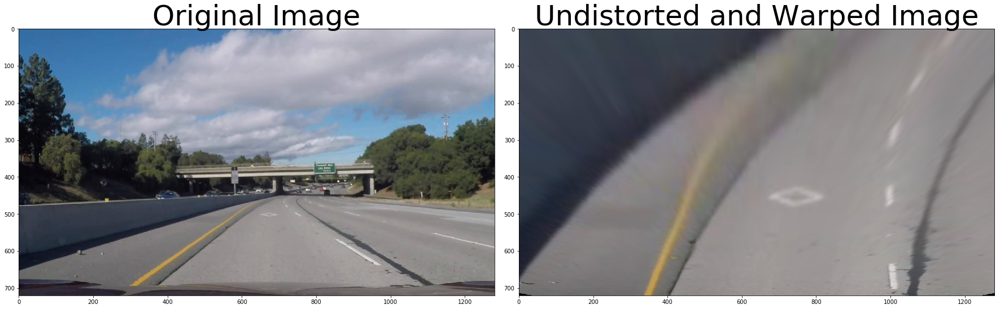

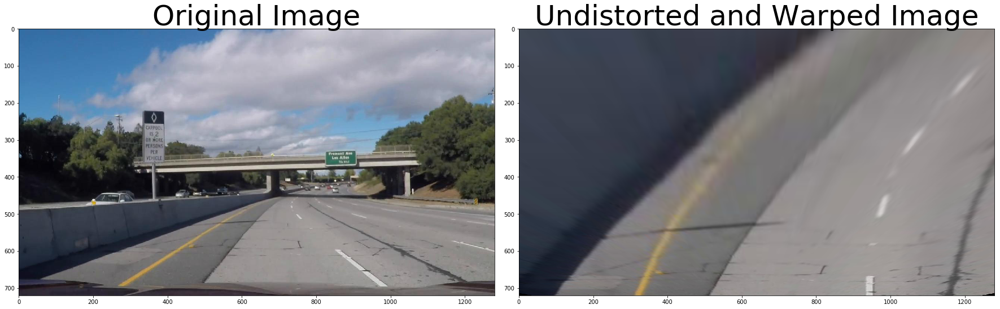

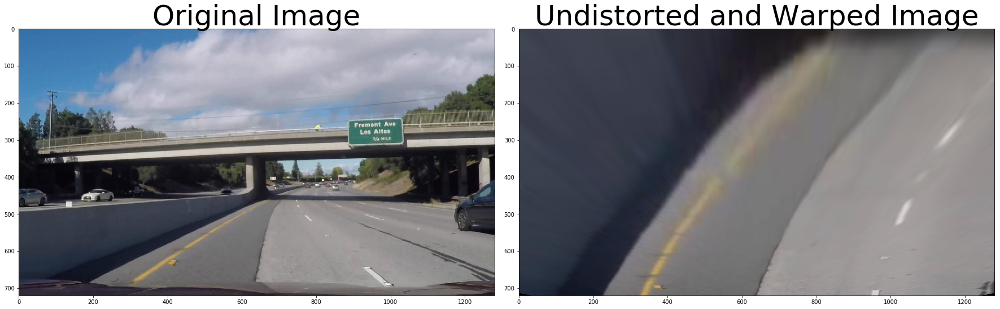

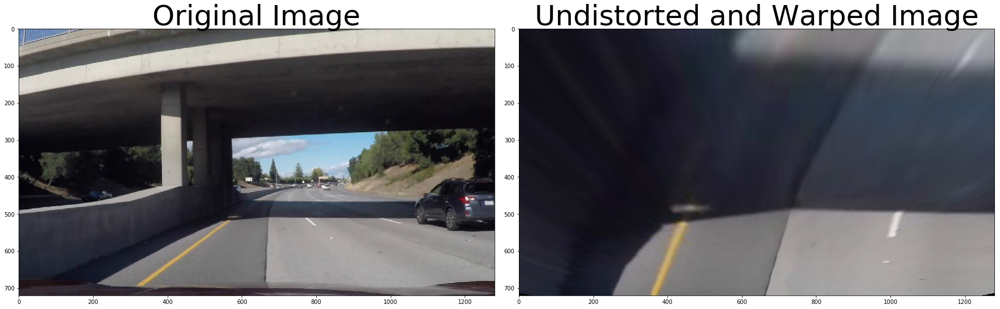

...

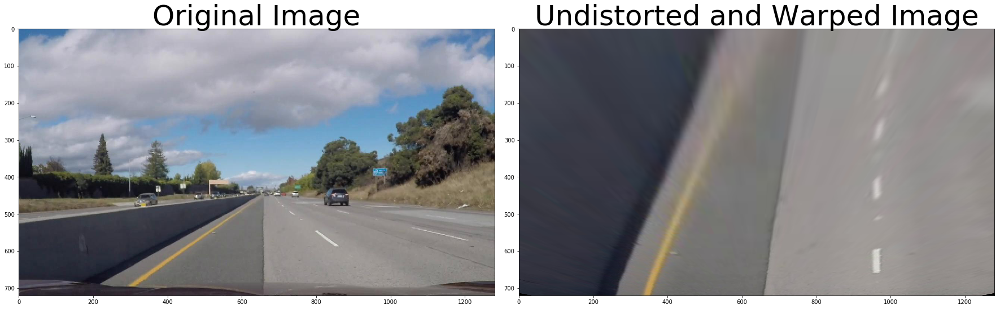

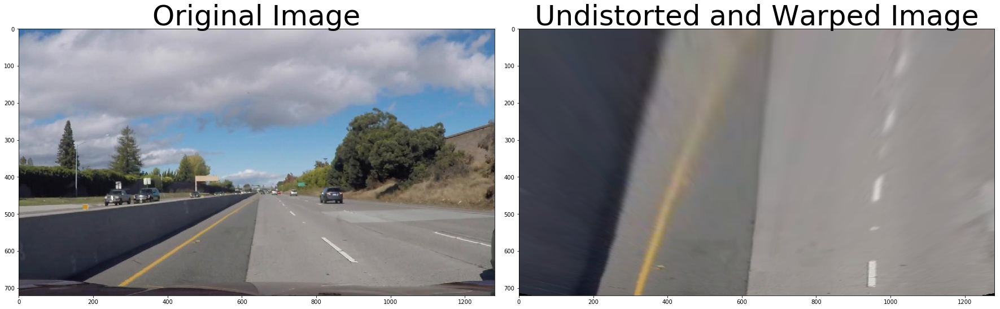

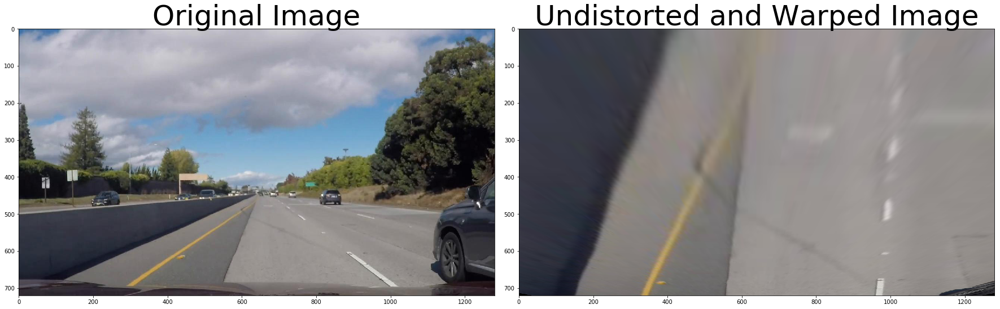

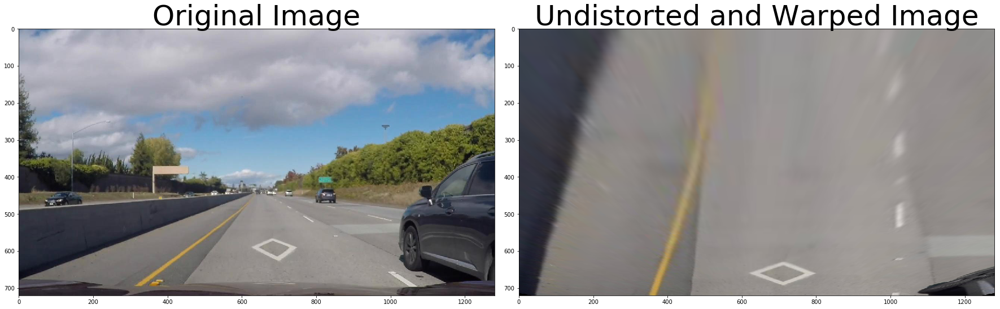

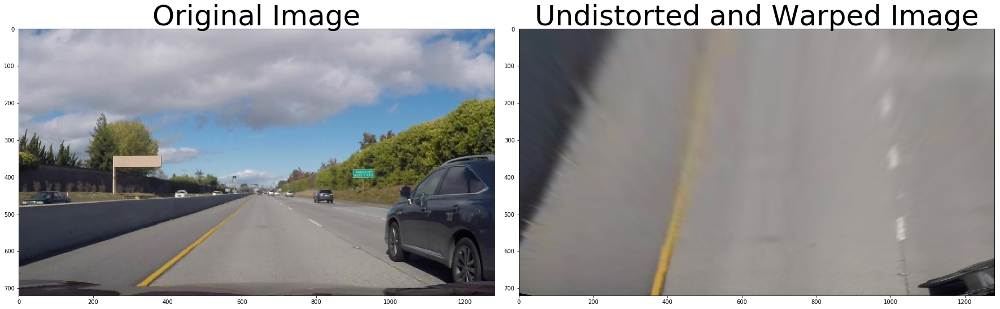

In [12]:
import pickle
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

    
def warp_lanes(img, unwarp=False):
    # set up source and destintation points for warp 
    img_size = (img.shape[1],img.shape[0])
    src_pts = np.array([
        [0.54, 0.64],
        [0.78, 0.925],
        [0.22, 0.925],
        [0.46, 0.64]
    ], np.float32)
    src_pts = np.float32(src_pts * img_size)
    dst_pts = np.array([
        [0.78, 0.01],
        [0.78, 0.99],
        [0.22, 0.99],
        [0.22, 0.01]
    ], np.float32)
    dst_pts = np.float32(dst_pts * img_size)
    if (unwarp == False):
        # create a transform matrix
        M = cv2.getPerspectiveTransform(src_pts, dst_pts)
        # warp your image to top-down view
        warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    else:
        # create a transform matrix
        M = cv2.getPerspectiveTransform(dst_pts, src_pts)
        # warp your image to top-down view
        warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
        
    return warped

#Load camera undistortion matrices if necessary
dist_pickle = pickle.load( open( camcalpath + "dist_pickle.p", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]
    
# Make a list of calibration images
images = glob.glob(moretestpath + '*.jpg')

for idx, fname in enumerate(images):
    # Read in an image
    img = cv2.imread(fname)
    #img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    if img is None:
        print('Image not read')
        
    # Undistort using mtx and dist
    undist = undistort(img, mtx, dist)
    
    # warp image
    top_down = warp_lanes(undist)
    
    # save warped images
    cv2.imwrite(morewarpedtestpath + 'warped' + str(idx) + '.jpg',top_down)
    
    
    #Display warped images
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(cv2.cvtColor(top_down, cv2.COLOR_BGR2RGB))
    ax2.set_title('Undistorted and Warped Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()


## Color and gradient thresholding

Apply color and gradient thresholds to the warped image to make lane lines more distinctive.

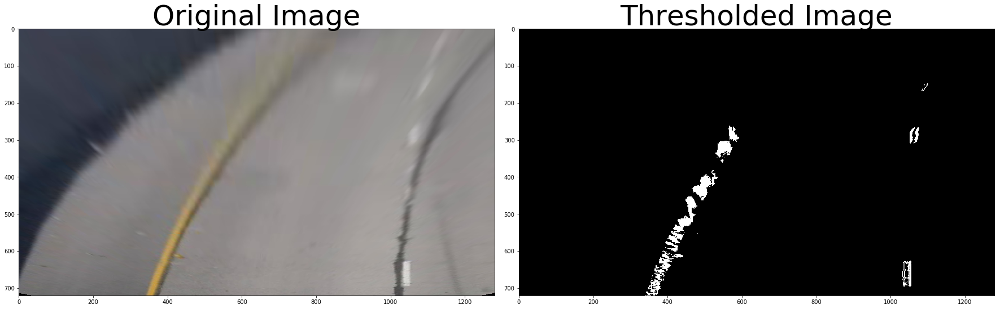

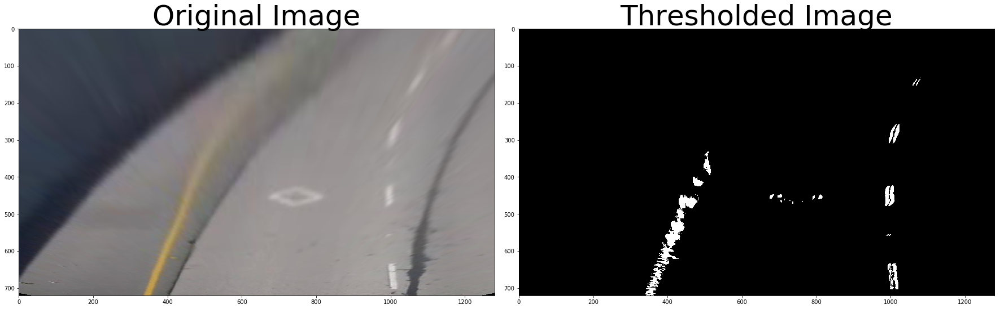

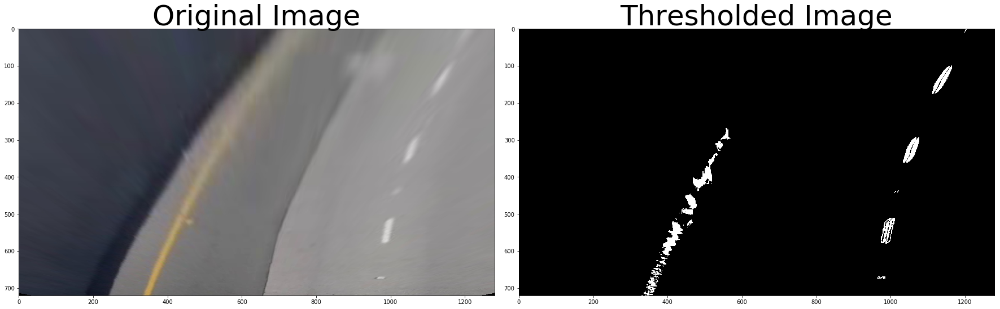

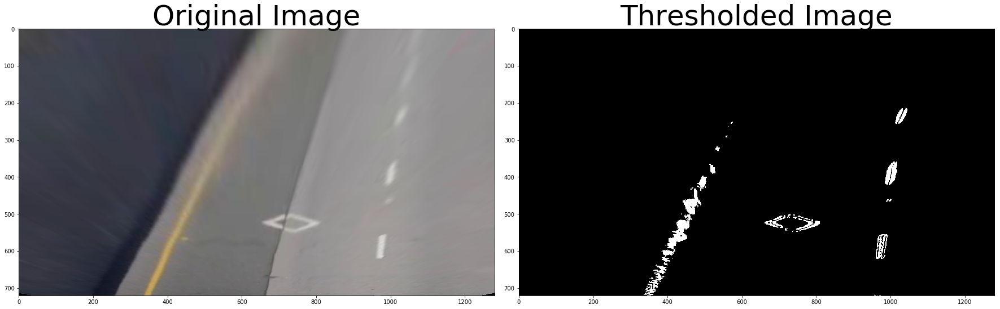

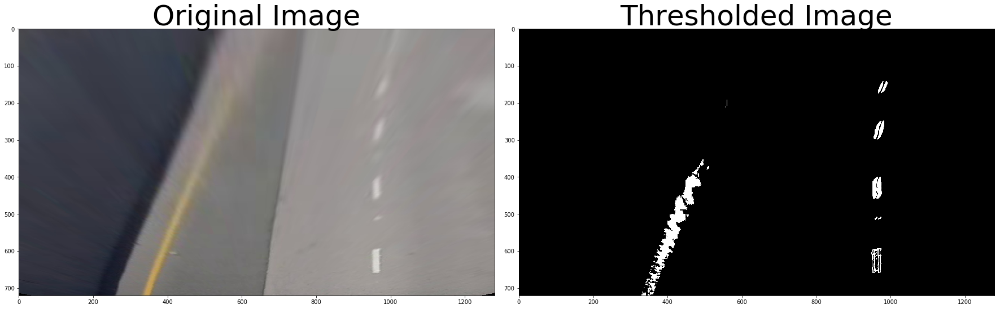

...

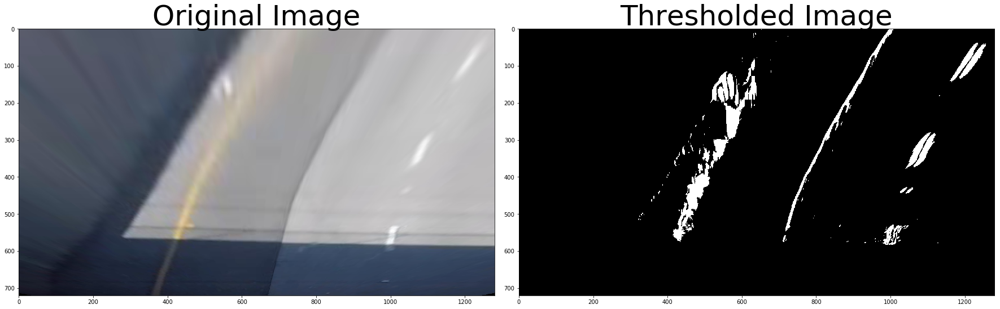

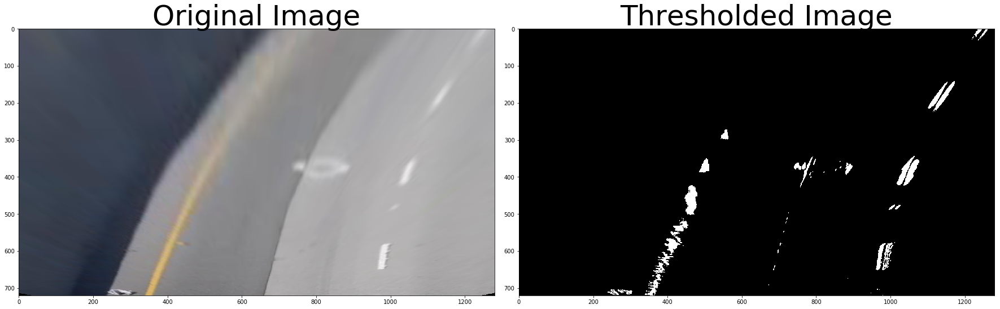

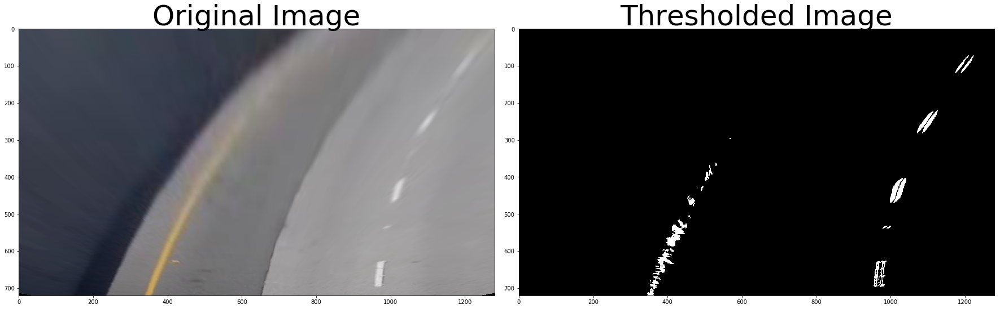

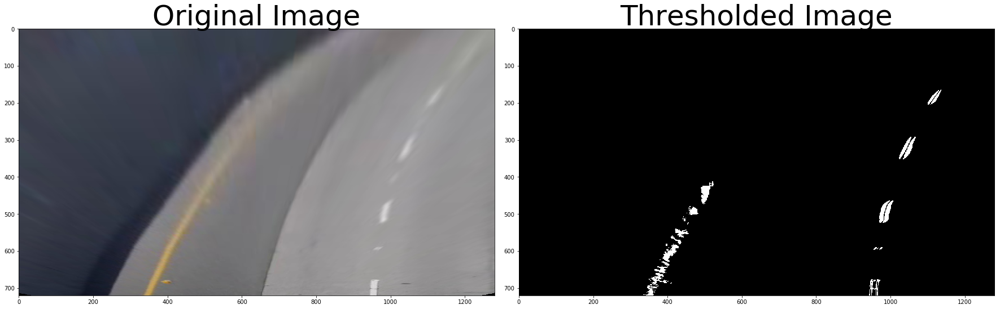

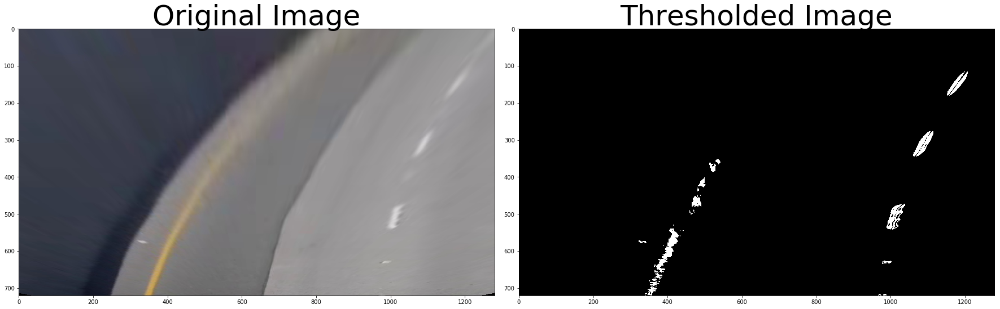

In [97]:
# Apply several thresholds and return a composite image with the thresholds in each channel
def thresholder(img, s_thresh=(170, 255), l_thresh=(170, 255), sx_thresh=(20, 100), sy_thresh=(20, 100), sobel_ksize=3, merged=True):
    img = np.copy(img)
    # Convert to HLS color space and separate the L, S channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    
    # Red and Green channel
    # FOR WHITE LANE LINES
    #
    
    # Apply CLAHE to l_channel
    clahe = cv2.createCLAHE(clipLimit=1.0, tileGridSize=(8,8))
    #l_channel = clahe.apply(l_channel)
    h_channel_eq = np.where((h_channel < 0),0,h_channel)
    l_channel_eq = np.where((l_channel < 170),170,l_channel)
    s_channel_eq = np.where((s_channel > 40),40,s_channel)
    #threshed_img = cv2.cvtColor(np.dstack((h_channel_eq, l_channel_eq, s_channel_eq)), cv2.COLOR_HLS2RGB)

    # RED:   Sobel y
    sobely = cv2.Sobel(l_channel_eq, cv2.CV_64F, 1, 0, ksize=sobel_ksize) # Take the derivative in x
    abs_sobely = np.absolute(sobely) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobely = np.uint8(255*abs_sobely/np.max(abs_sobely))
    # Threshold y gradient
    sybinary = np.zeros_like(scaled_sobely)
    sybinary[(scaled_sobely >= sy_thresh[0]) & (scaled_sobely <= sy_thresh[1])] = 1
    
    # GREEN: Sobel x
    sobelx = cv2.Sobel(l_channel_eq, cv2.CV_64F, 1, 0, ksize=sobel_ksize) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobelx = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobelx)
    sxbinary[(scaled_sobelx >= sx_thresh[0]) & (scaled_sobelx <= sx_thresh[1])] = 1
    
    
    # Blue channel
    # FOR YELLOW LANE LINES
    #
    
    # BLUE:  Threshold color channel (for yellow lane lines)
    h_binary = np.zeros_like(h_channel)
    h_binary[(h_channel >= 20) & (h_channel <= 40)] = 1
    l_binary = np.zeros_like(l_channel)
    l_binary[(l_channel >= l_thresh[0]) & (l_channel <= l_thresh[1])] = 1
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    color_binary = l_binary * s_binary * h_binary    
    
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
    if merged:
        output = np.logical_or(np.logical_or(sybinary, sxbinary), color_binary)
    else:
        output = np.dstack(( sybinary, sxbinary, color_binary))
    
    return output

# Make a list of calibration images
images = glob.glob(morewarpedtestpath + 'warped*.jpg')

for idx, fname in enumerate(images):
    # Read in an image
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    # Apply threshhold to l_channel
    #value = 80
    #l_channel_eq = np.where((l_channel - value) < 0,0,l_channel-value)
    clahe = cv2.createCLAHE(clipLimit=0.5, tileGridSize=(8,8))
    l_channel = clahe.apply(l_channel)
    s_channel = clahe.apply(s_channel)
    h_channel_eq = np.where((h_channel < 0),0,h_channel)
    #l_channel_eq = np.where((l_channel < 128),0,l_channel)
    l_channel_eq = l_channel
    l_channel_eq[l_channel_eq < 170] = 170
#    l_channel_eq = l_channel_eq.astype(float) / 255
    s_channel_eq = s_channel
#    s_channel_eq[s_channel_eq < 20] = 20
    s_channel_eq[s_channel_eq > 40] = 40
#    s_channel_eq = s_channel_eq.astype(float) / 255
    combo = l_channel_eq * s_channel_eq
    #s_channel_eq = np.where((s_channel > 50),50,s_channel)
    #s_channel_eq = np.where((s_channel_eq < 10),0,s_channel_eq)
    threshed_img = cv2.cvtColor(np.dstack((h_channel_eq, l_channel_eq, s_channel_eq)), cv2.COLOR_HLS2RGB)
    
    
    if img is None:
        print('Image not read')

    # threshold already-warped image
    thresholded = thresholder(img, s_thresh=(30, 240), l_thresh=(30,240), sx_thresh=(20, 160),  sy_thresh=(20, 160), 
                              sobel_ksize=7, merged=True)
    # save thresholded images
    cv2.imwrite(morewarpedtestpath + 'threshold' + str(idx) + '.jpg',thresholded.astype(int)*255)
    
    
    #Display thresholded images
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    if len(thresholded.shape) < 3 or thresholded.shape[2] == 1:
        ax2.imshow(thresholded, cmap='gray')
    elif thresholded.shape[2] == 3:
        result = cv2.addWeighted(img, 0.5, (thresholded * 255).astype(np.uint8), 1, 0)
        ax2.imshow(result)
    ax2.set_title('Thresholded Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

## Find lane pixels
Use a sliding window to find the most likely lane pixels on the left and right sides.

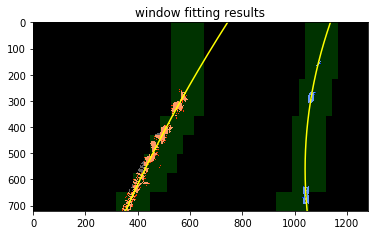

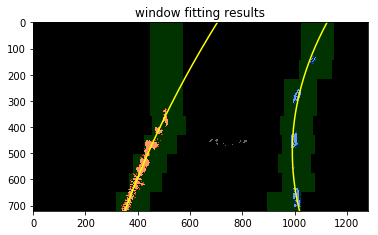

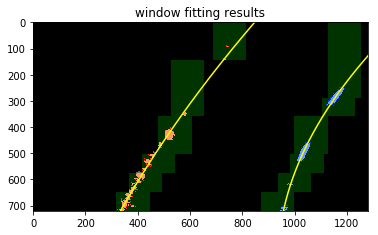

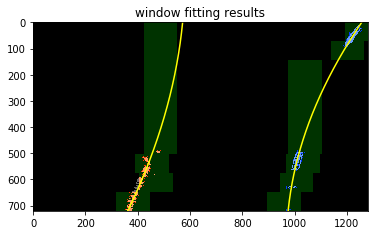

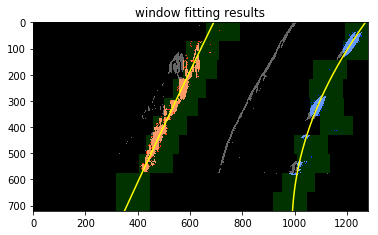

...

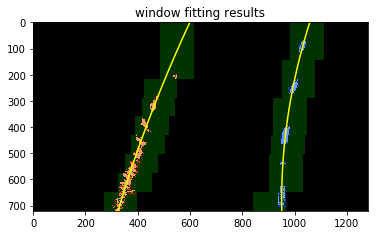

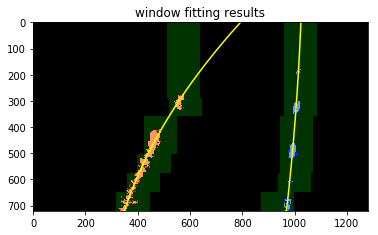

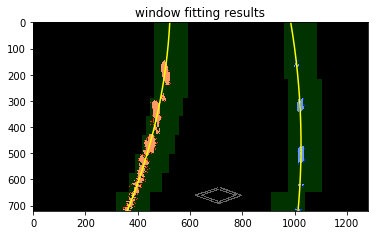

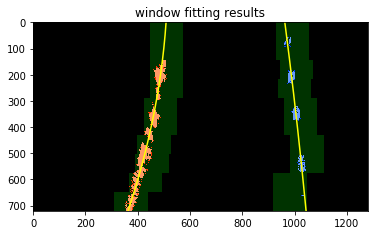

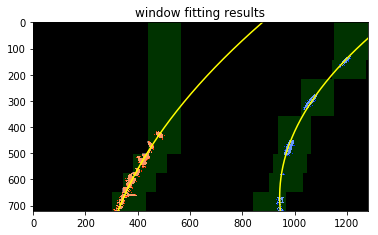

In [31]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import cv2


def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

def find_window_centroids(image, window_width, window_height, margin, min_filled=0.05):
    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(image[int(3*image.shape[0]/4):,:int(image.shape[1]*0.35)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(image[int(3*image.shape[0]/4):,int(image.shape[1]*0.65):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(image.shape[1]*0.65)
    
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(image.shape[0]/window_height)):
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(image[int(image.shape[0]-(level+1)*window_height):int(image.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,image.shape[1]))
        #find the peak of the convolution
        l_maxconv = np.argmax(conv_signal[l_min_index:l_max_index])
        # Only move the window from the previous center if a good number of pixels are found
        if conv_signal[int(l_maxconv+l_min_index)] > window_width*window_height*min_filled: 
            l_center = l_maxconv+l_min_index
        
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,image.shape[1]))
        r_maxconv = np.argmax(conv_signal[r_min_index:r_max_index])
        # Only move the window from the previous center if a good number of pixels are found
        if conv_signal[int(r_maxconv+r_min_index)] > window_width*window_height*min_filled: 
            r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index
        
        # Add what we found for that layer
        window_centroids.append((l_center,r_center))

    return window_centroids


def draw_centroids(img, window_width, window_height, margin):
    window_centroids = None
    window_centroids = find_window_centroids(img, window_width, window_height, margin)

    # If we found any window centers
    if window_centroids and len(window_centroids) > 0:

        # Points used to draw all the left and right windows
        l_search_area = np.zeros_like(img)
        r_search_area = np.zeros_like(img)

        # Go through each level and draw the windows     
        for level in range(0,len(window_centroids)):
            # Window_mask is a function to draw window areas
            l_mask = window_mask(window_width,window_height,img,window_centroids[level][0],level)
            r_mask = window_mask(window_width,window_height,img,window_centroids[level][1],level)
            # Add graphic points from window mask here to total pixels found 
            l_search_area[(l_search_area == 255) | ((l_mask == 1) ) ] = 255
            r_search_area[(r_search_area == 255) | ((r_mask == 1) ) ] = 255


        zero_channel = np.zeros_like(l_search_area) # create a zero color channel

        # create the two sets of points
        l_points = np.zeros_like(l_search_area)
        r_points = np.zeros_like(r_search_area)
        l_points[(l_search_area>0) & (img>1)] = 255
        r_points[(r_search_area>0) & (img>1)] = 255
        
        
        # mark left pixels red
        l_points_color = np.array(cv2.merge((l_points,zero_channel,zero_channel)),np.uint8)
        # mark right pixels blue
        r_points_color = np.array(cv2.merge((zero_channel,zero_channel,r_points)), np.uint8)
        
        merged_points_color = l_points_color + r_points_color
        
        # Draw the window green
        template = np.array(r_search_area+l_search_area,np.uint8) # add both left and right window pixels together
        template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
        
        warpage = np.array(cv2.merge((img,img,img)),np.uint8) # making the original road pixels 3 color channels        
        output = cv2.addWeighted(template, 0.2, merged_points_color, 1.0, 0.0)
        output = cv2.addWeighted(warpage, 0.4, output, 1.0, 0.0) # overlay the orignal road image with window results

    # If no window centers found, just display orginal road image
    else:
        output = np.array(cv2.merge((img,img,img)),np.uint8)
    return l_points, r_points, output

def measure_curvature(left_line, right_line, y_height):
    if (left_line.data_points[0].size <= 0 or right_line.data_points[0].size <=0):
            raise ValueError('no points')
    # Define conversions in x and y from pixels space to meters
    y_eval = y_height-1
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    left_fit = np.polyfit(left_line.data_points[0], left_line.data_points[1], 2)
    right_fit = np.polyfit(right_line.data_points[0], right_line.data_points[1], 2)
    left_line.current_fit = left_fit
    right_line.current_fit = right_fit

    ploty = np.linspace(0, y_height-1, y_height )
    left_line.xfitted = left_line.current_fit[0]*ploty**2 + left_line.current_fit[1]*ploty + left_line.current_fit[2]
    right_line.xfitted = right_line.current_fit[0]*ploty**2 + right_line.current_fit[1]*ploty + right_line.current_fit[2]
    
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(left_line.data_points[0]*ym_per_pix, left_line.data_points[1]*xm_per_pix, 2)
    right_fit_cr = np.polyfit(right_line.data_points[0]*ym_per_pix, right_line.data_points[1]*xm_per_pix, 2)
    
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
    left_line.radius_of_curvature = left_curverad
    right_line.radius_of_curvature = right_curverad


# Make a list of calibration images
images = glob.glob(morewarpedtestpath + 'threshold*.jpg')

# used to store the extracted features of each image
lines = []

for idx, fname in enumerate(images):
    # Read in an image
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    if img is None:
        print('Image not read')

    left_line = Line()
    right_line = Line()
    left_line.fname = fname
    right_line.fname = fname

    # draw windows for thresholded windows
    # window settings
    window_width = int(img.shape[1] / 10)
    window_height = int(img.shape[0] / 10) # Break image into 9 vertical layers since image height is 720
    margin = 100 # How much to slide left and right for searching


    l_points, r_points, output = draw_centroids(img, window_width, window_height, margin)
    
    left_line.data_points = l_points.nonzero()
    right_line.data_points = r_points.nonzero()
    
    measure_curvature(left_line, right_line, img.shape[0])
    
    lines.append([left_line,right_line])
    
    
    # save thresholded images
    #cv2.imwrite(warpedtestpath + 'threshold' + str(idx) + '.jpg',thresholded.astype(int)*255)
    
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0])

    # Display the final results
    plt.imshow(output)
    plt.xlim(0, img.shape[1])
    plt.ylim(img.shape[0], 0)
    plt.plot(left_line.xfitted, ploty, color='yellow')
    plt.plot(right_line.xfitted, ploty, color='yellow')
    plt.title('window fitting results')
    plt.show()


## Averaging between frames


In [32]:
#set up the fit values, and do an average fit, based on the past frames
def average_frames(left_line, right_line, lines, ymax, a_limit=0.003, b_limit=2.0, c_limit=5000):
    ploty = np.linspace(0, ymax-1, ymax )
    
    if len(lines) > 0: 
        left_line.recent_xfitted = lines[-1][0].recent_xfitted.copy()
        right_line.recent_xfitted = lines[-1][1].recent_xfitted.copy()
    
    if len(left_line.xfitted) > 0:    
        # limit to at least 6 values before we apply rejection thresholds
        if len(left_line.recent_xfitted) > 6:
            left_line.diffs = np.array(lines[-1][0].best_fit - left_line.current_fit)
        else:
            left_line.diffs = np.array([0.0, 0.0, 0.0], dtype=float)

        if (abs(left_line.diffs[0]) < a_limit and
           abs(left_line.diffs[1]) < b_limit and
           abs(left_line.diffs[2]) < c_limit):
            left_line.recent_xfitted.append(list(zip(ploty, left_line.xfitted)))
            left_arr = np.concatenate(left_line.recent_xfitted)
            left_arr = left_arr.reshape(int(len(left_arr)),2)
            left_line.best_fit = np.polyfit(left_arr[:,0], left_arr[:,1], 2)
            left_line.bestx = left_line.best_fit[0]*ploty**2 + left_line.best_fit[1]*ploty + left_line.best_fit[2]
        else:
            #print('l d_0: ', abs(left_line.diffs[0]),
            #  'd_1:', abs(left_line.diffs[1]),
            #  'd_2:', abs(left_line.diffs[2]))
            left_line.best_fit = lines[-1][0].best_fit
            left_line.bestx = lines[-1][0].bestx
    
    
    if len(right_line.xfitted) > 0:
        # limit to at least 6 values before we apply rejection thresholds
        if len(right_line.recent_xfitted) > 6:
            right_line.diffs = np.array(lines[-1][1].best_fit - right_line.current_fit)
        else:
            right_line.diffs = np.array([0.0, 0.0, 0.0], dtype=float)
            
            
        if (abs(right_line.diffs[0]) < a_limit and
            abs(right_line.diffs[1]) < b_limit and
            abs(right_line.diffs[2]) < c_limit):
            right_line.recent_xfitted.append(list(zip(ploty, right_line.xfitted)))
            right_arr = np.concatenate(right_line.recent_xfitted)
            right_arr = right_arr.reshape(int(len(right_arr)),2)
            right_line.best_fit = np.polyfit(right_arr[:,0], right_arr[:,1], 2)
            right_line.bestx = right_line.best_fit[0]*ploty**2 + right_line.best_fit[1]*ploty + right_line.best_fit[2]
        else:
            #print('r d_0: ', abs(right_line.diffs[0]),
            #  'd_1:', abs(right_line.diffs[1]),
            #  'd_2:', abs(right_line.diffs[2]))
            right_line.best_fit = lines[-1][1].best_fit
            right_line.bestx = lines[-1][1].bestx
    
    lines.append([left_line,right_line])


## Full pipeline

Now we will take images again and process the full pipeline

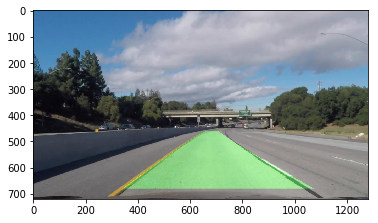

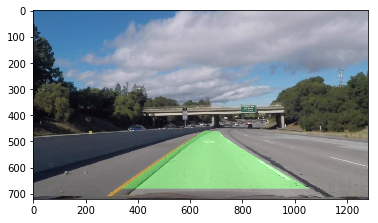

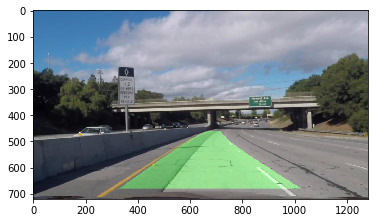

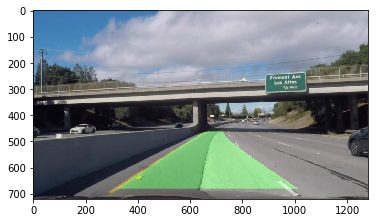

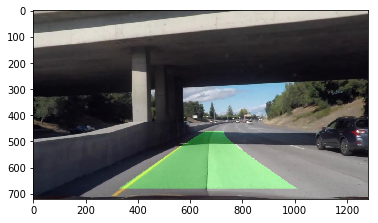

...

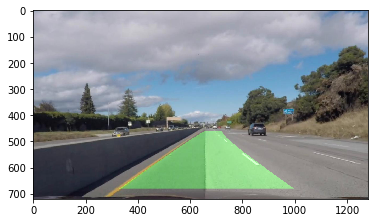

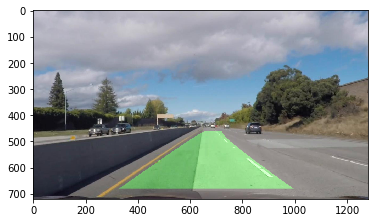

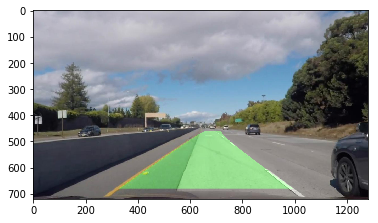

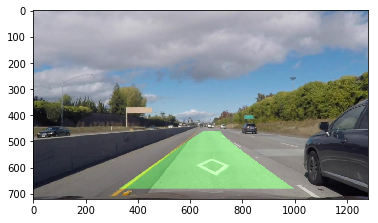

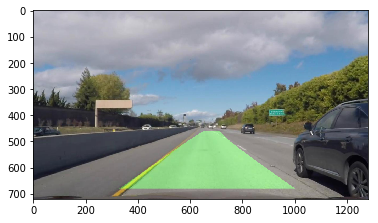

In [33]:
#Load camera undistortion matrices if necessary
dist_pickle = pickle.load( open( camcalpath + "dist_pickle.p", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]

# Make a list of calibration images
images = glob.glob(moretestpath + '*.jpg')

# used to store the extracted features of each image
lines = []

for idx, fname in enumerate(images):
    # Read in an image
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    if img is None:
        print('Image not read')

    # Undistort using mtx and dist
    undist = undistort(img, mtx, dist)
    
    # warp image
    top_down = warp_lanes(undist)
    
    # threshold already-warped image
    #s_thresh=(20, 255), l_thresh=(12,255), sx_thresh=(20, 200), sy_thresh=(20, 200),
    thresholded = thresholder(top_down, s_thresh=(20, 255), l_thresh=(12,255), sx_thresh=(10, 160),  sy_thresh=(10, 160),
                              sobel_ksize=7, merged=True).astype(np.uint8)*255
    
    left_line = Line()
    right_line = Line()
    left_line.fname = fname
    right_line.fname = fname

    # draw windows for thresholded windows
    # window settings
    window_width = int(thresholded.shape[1] / 10)
    window_height = int(thresholded.shape[0] / 8) # Break image into 9 vertical layers since image height is 720
    margin = 120 # How much to slide left and right for searching
    
    l_points, r_points, output = draw_centroids(thresholded, window_width, window_height, margin)
    
    left_line.data_points = l_points.nonzero()
    right_line.data_points = r_points.nonzero()
    
    measure_curvature(left_line, right_line, thresholded.shape[0])
    average_frames(left_line, right_line, lines, thresholded.shape[0])
    
    ploty = np.linspace(0, thresholded.shape[0]-1, thresholded.shape[0] )
    left_fitx = left_line.current_fit[0]*ploty**2 + left_line.current_fit[1]*ploty + left_line.current_fit[2]
    right_fitx = right_line.current_fit[0]*ploty**2 + right_line.current_fit[1]*ploty + right_line.current_fit[2]

    # Create an image to draw the lines on
    warp_zero = np.zeros_like(thresholded).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_line.bestx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_line.bestx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = warp_lanes(color_warp, unwarp=True)
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    plt.imshow(result)
    plt.show()


# Process video 

Create a video pipeline and do the same steps on video

In [92]:
#Load camera undistortion matrices if necessary
dist_pickle = pickle.load( open( camcalpath + "dist_pickle.p", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]


def process_image(img):
    # Undistort using mtx and dist
    undist = undistort(img, mtx, dist)
    
    # warp image
    top_down = warp_lanes(undist)
    
    # threshold already-warped image
    thresholded = thresholder(top_down, s_thresh=(20, 255), l_thresh=(12,255), sx_thresh=(10, 160),  sy_thresh=(10, 160),
                              sobel_ksize=7, merged=True).astype(np.uint8)*255
    
    left_line = Line()
    right_line = Line()
    left_line.fname = fname
    right_line.fname = fname

    # draw windows for thresholded windows
    # window settings
    window_width = int(thresholded.shape[1] / 10)
    window_height = int(thresholded.shape[0] / 10) # Break image into 9 vertical layers since image height is 720
    margin = 100 # How much to slide left and right for searching
    
    l_points, r_points, output = draw_centroids(thresholded, window_width, window_height, margin)
    
    

    # Create an image to draw the lines on
    warp_zero = np.zeros_like(thresholded).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    ploty = np.linspace(0, thresholded.shape[0]-1, thresholded.shape[0] )
    try:
        if (l_points.shape[0] <= 0 or r_points.shape[0] <=0):
            raise ValueError('no points')
            
        left_line.data_points = l_points.nonzero()
        right_line.data_points = r_points.nonzero()
    except ValueError:
        left_line.data_points = ([],[])
        right_line.data_points = ([],[])
        
    try:
        measure_curvature(left_line, right_line, thresholded.shape[0])
    except ValueError:
        left_line.current_fit = lines[-1][0].current_fit.copy()
        right_line.current_fit = lines[-1][1].current_fit.copy()
        left_line.radius_of_curvature = lines[-1][0].radius_of_curvature.copy()
        right_line.radius_of_curvature = lines[-1][1].radius_of_curvature.copy()
        left_line.best_fit = lines[-1][0].best_fit.copy()
        right_line.best_fit = lines[-1][1].best_fit.copy()
        left_line.bestx = lines[-1][0].bestx.copy()
        right_line.bestx = lines[-1][1].bestx.copy()
        pass


    average_frames(left_line, right_line, lines, thresholded.shape[0])

    left_fitx = left_line.current_fit[0]*ploty**2 + left_line.current_fit[1]*ploty + left_line.current_fit[2]
    right_fitx = right_line.current_fit[0]*ploty**2 + right_line.current_fit[1]*ploty + right_line.current_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_line.bestx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_line.bestx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    
    lookback = 20 if len(lines) >= 20 else len(lines)
    prev_lines = lines[-lookback:]
    prev_rads = [left.radius_of_curvature for left in [line[0] for line in prev_lines]]
    prev_rads.extend([right.radius_of_curvature for right in [line[1] for line in prev_lines]])
    rad_avg = np.mean(prev_rads)
    rad_string = 'c_rad:{:.3f}'.format(rad_avg) 

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = warp_lanes(color_warp, unwarp=True)
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    cv2.putText(result,rad_string,(50,100), cv2.FONT_HERSHEY_SIMPLEX, 2,(255,0,255),2,cv2.LINE_AA)
    return result

In [98]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip

lines = []

project_video = 'challenge_video.mp4'
output_video = project_video.split('.')[0] + '_output.mp4'
clip1 = VideoFileClip(project_video)
#clip1 = clip1.subclip(3,6)
clip1_highlighted = clip1.fl_image(process_image) #NOTE: this function expects color images!!


In [99]:
lines = []
%time clip1_highlighted.write_videofile(output_video, audio=False)
l_diffs = [line[0].diffs for line in lines]
r_diffs = [line[1].diffs for line in lines]
print('lstd:', np.std(l_diffs))
print('rstd:', np.std(r_diffs))    

[MoviePy] >>>> Building video challenge_video_output.mp4
[MoviePy] Writing video challenge_video_output.mp4


100%|██████████| 485/485 [01:44<00:00,  4.00it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_output.mp4 

CPU times: user 1min 51s, sys: 23.1 s, total: 2min 14s
Wall time: 1min 44s
lstd: 20033.8844125
rstd: 31.2512803536


In [100]:
from IPython.display import HTML

HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output_video))